In [1]:
import scanpy as sc
import pandas as pd
from pathlib import Path
import anndata as ad
import numpy as np

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

DPI = 300
FONTSIZE = 20  # 42

sc.settings.set_figure_params(
    scanpy=True, dpi=100, transparent=True, vector_friendly=True, dpi_save=DPI
)
from matplotlib import rcParams

rcParams["pdf.fonttype"] = 42

In [2]:
DIR2SAVE = Path("/data/BCI-CRC/nasrine/data/CRC/Primary_CRC_dataset/20mt/annotation_global/")

In [3]:
FIG2SAVE = DIR2SAVE.joinpath("figures/")
FIG2SAVE
# set the global variable: sc.settings.figdir to save all plots
sc.settings.figdir = FIG2SAVE

In [4]:
DIR2SAVE.mkdir(parents=True, exist_ok=True)
FIG2SAVE.mkdir(parents=True, exist_ok=True)

In [5]:
adata_crc = sc.read_h5ad(
    "/data/BCI-CRC/nasrine/data/CRC/Primary_CRC_dataset/20mt/data_integration/SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg.h5ad"
)
adata_crc.shape

(328063, 2000)

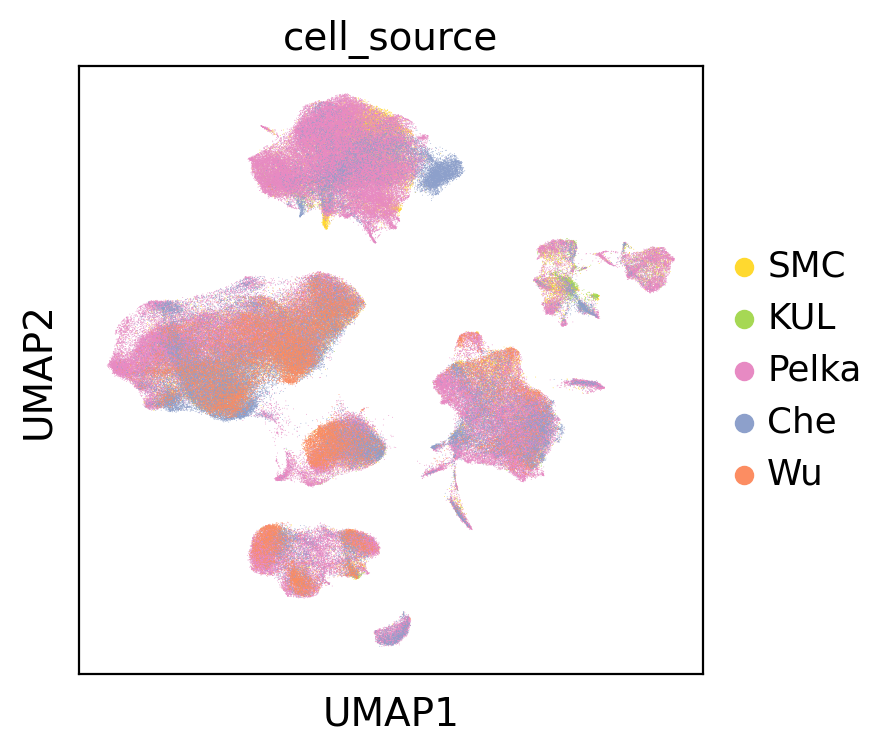

In [6]:
sc.pl.umap(adata_crc, color="cell_source", show=True)

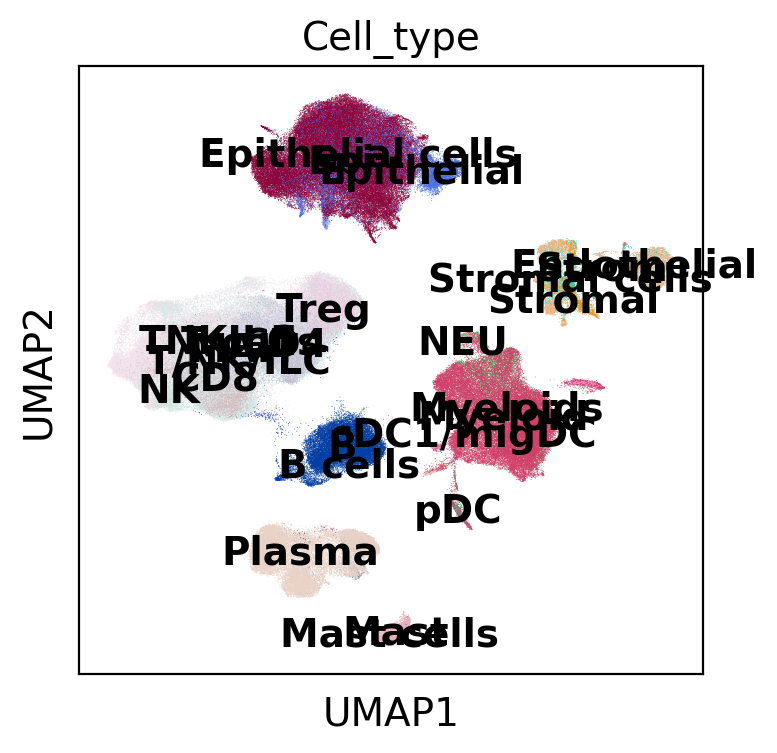

In [7]:
sc.pl.umap(adata_crc, color="Cell_type", legend_loc="on data")

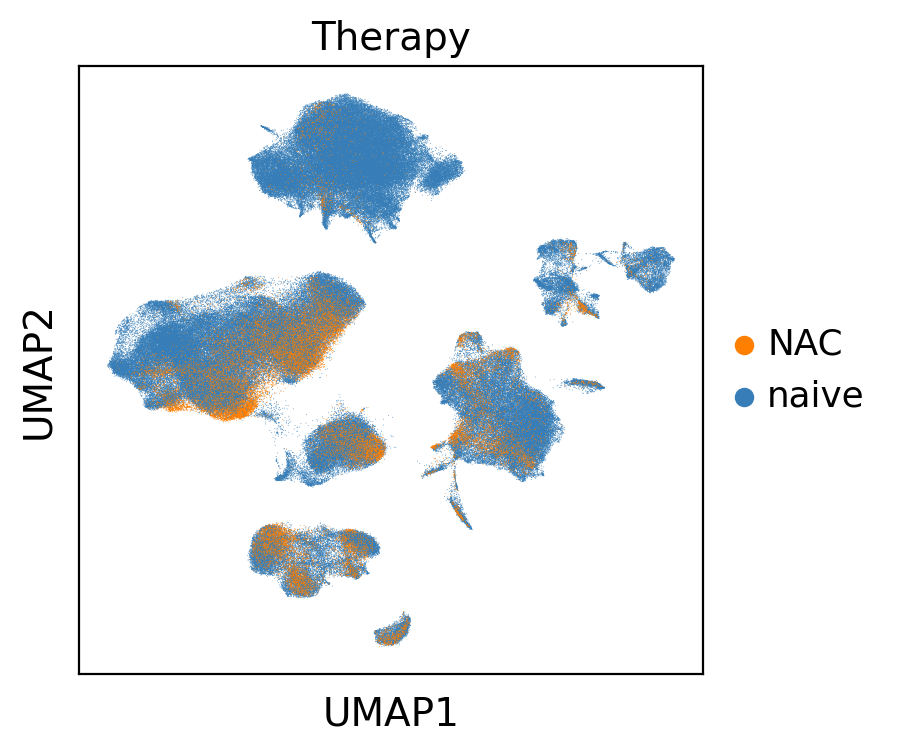

In [8]:
sc.pl.umap(adata_crc, color="Therapy", show=True)

### Leiden clustering

In [9]:
adata_crc.uns["neighbors"]

OverloadedDict, wrapping:
	{'connectivities_key': 'connectivities', 'distances_key': 'distances', 'params': {'method': 'umap', 'metric': 'euclidean', 'n_neighbors': 15, 'n_pcs': 10, 'random_state': 7, 'use_rep': 'X_scVI'}}
With overloaded keys:
	['connectivities', 'distances'].

In [10]:
# neighbors were already computed using Harmony corrected PCs, so we perform clustering on that graph
sc.tl.leiden(adata_crc, key_added="leiden_scVI", resolution=0.2, random_state=7)

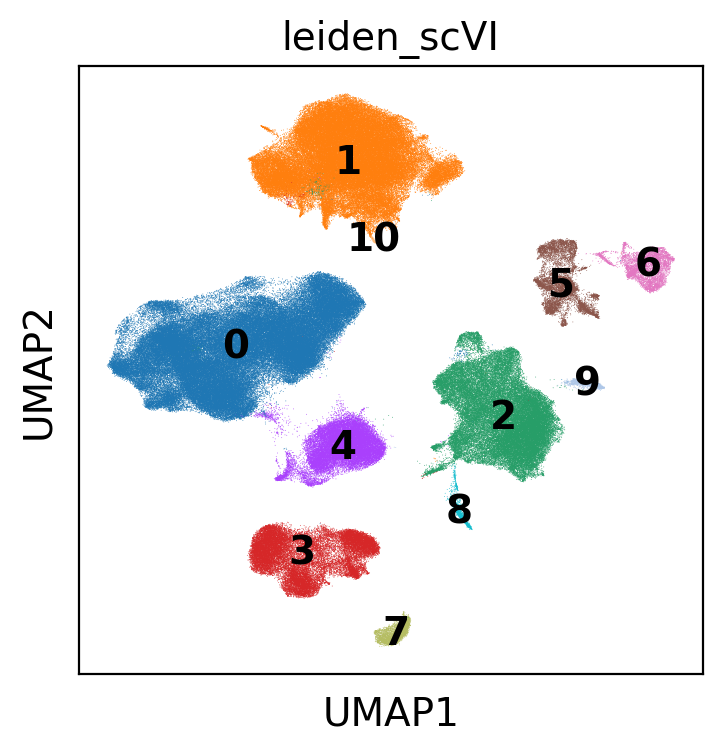

In [11]:
sc.pl.umap(
    adata_crc,
    color="leiden_scVI",
    legend_loc="on data",
    save="general_clustering.pdf",
    show=True,
)

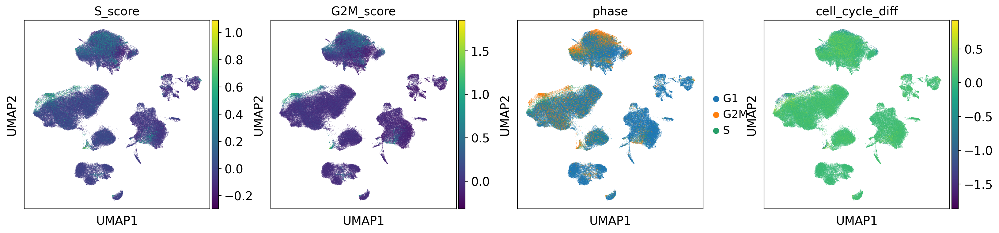

In [12]:
sc.pl.umap(adata_crc, color=["S_score", "G2M_score", "phase", "cell_cycle_diff"])

### Plot some markers 

In [13]:
markers = {
    "Epithelial": ["EPCAM", "CDH1"],
    "Myeloid": ["CD68", "CD14"],
    #'Kupffer': ['SLC11A1', 'CD5L', 'TIMD4', 'CETP'],
    "Granulocyte": ["CPA3", "GATA2", "TPSAB1"],
    "Neutrophil": [
        "FCGR3B",
        "S100A8",
        "S100A12",
        "MPO",
        "ELANE",
        "DEFA4",
        "DEFA3",
        "CEACAM6",
    ],
    "Stromal": ["DCN", "VCAM1", "COL1A1", "COL3A1"],
    "Endothelial": ["PECAM1", "CDH5", "LYVE1"],
    "T/NK/ILC": ["TRAC", "CD3D", "CD3E", "CD3G", "KLRB1", "GZMB"],
    "NK": ["EOMES", "CMC1", "GZMK", "XCL1", "NKG7", "PRF1", "NCR1", "NCAM1", "FCER1G"],
    "ILC": ["AREG", "TLE1", "IL4I1"],
    "Mast": ["KIT", "TPSAB1", "TPSB2", "MS4A2"],
    "B": ["CD79A", "MS4A1"],
    "Plasma B": ["SDC1", "MZB1"],
    #'Hepatocyte': ['ALB', 'TTR', 'APOA1', 'AFP'],
    #'Cholangiocyte': ['SOX9', 'EPCAM', 'KRT19', 'CLDN4', 'CLDN10', 'FXYD2'],
    "DC": ["FCER1A", "PKIB", "CD1C", "PCLAF", "CLEC10A", "CES1"],
}

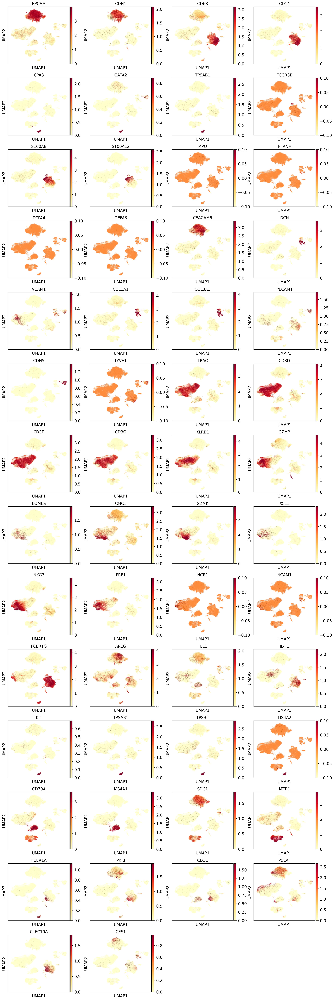

In [14]:
import itertools

# use log1p data stored in .raw
markers2plot = list(
    itertools.chain(*list(markers.values()))
)  # get all markers in a single list
sc.pl.umap(
    adata_crc,
    color=markers2plot,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="YlOrRd",  #'RdPu',
    save="general_markers.pdf",
    show=True,
)

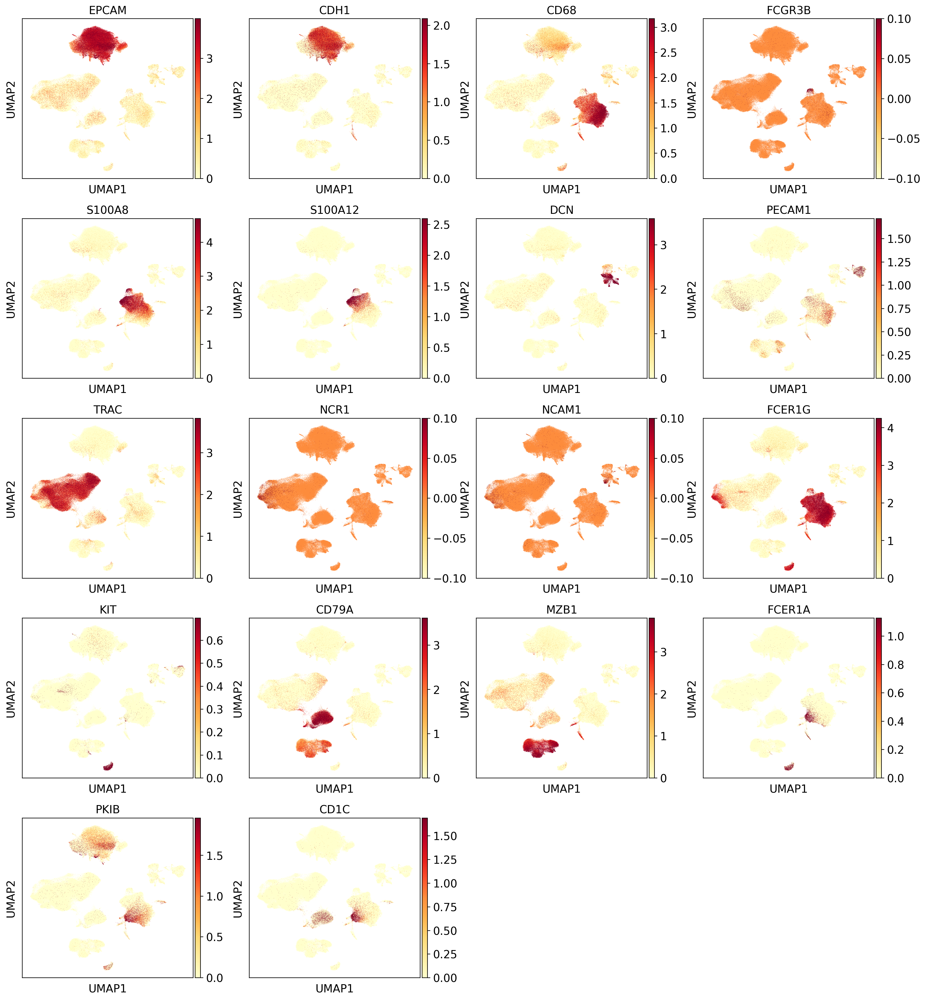

In [15]:
marker_subset = [
    "EPCAM",
    "CDH1",
    "CD68",
    "FCGR3B",
    "S100A8",
    "S100A12",
    "DCN",
    "PECAM1",
    "TRAC",
    "NCR1",
    "NCAM1",
    "FCER1G",
    "KIT",
    "CD79A",
    "MZB1",
    "FCER1A",
    "PKIB",
    "CD1C",
]
sc.pl.umap(
    adata_crc,
    color=marker_subset,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="YlOrRd",  #'YlGnBu',
    save="general_markers_subset.pdf",
    show=True,
)

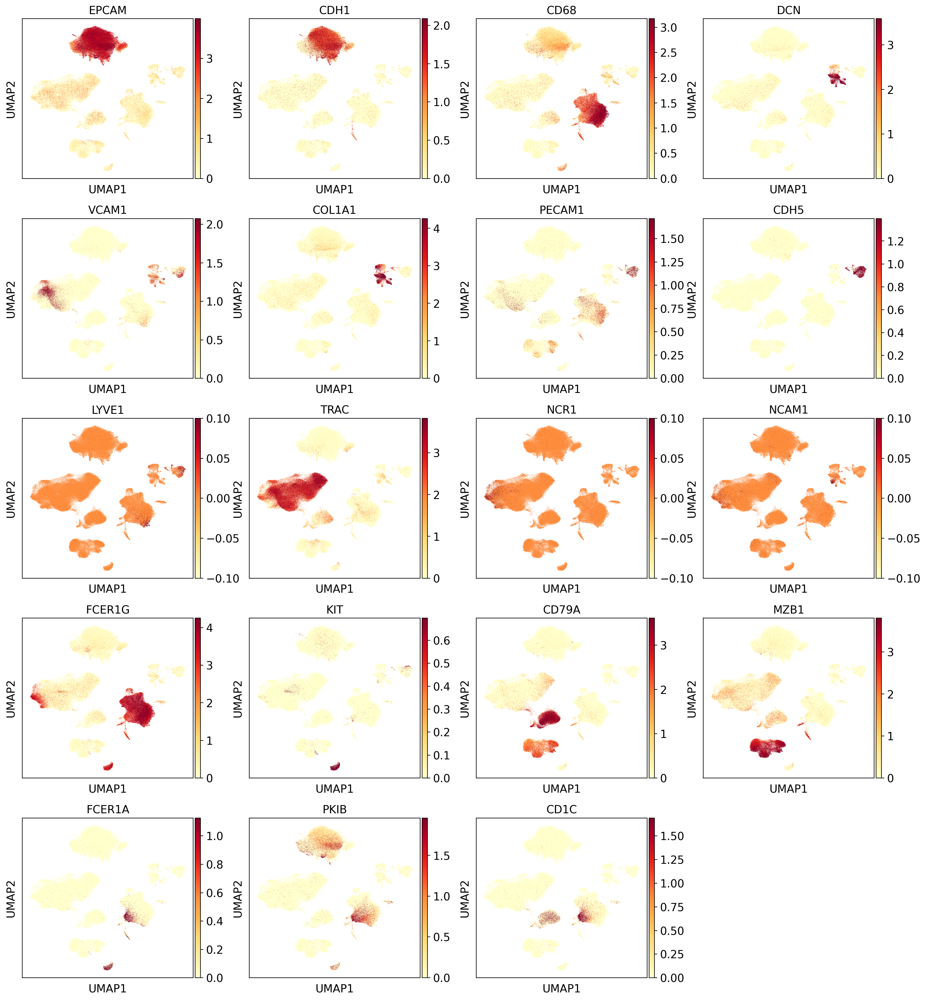

In [16]:
marker_subset = [
    "EPCAM",
    "CDH1",
    "CD68",
    "DCN",
    "VCAM1",
    "COL1A1",
    "PECAM1",
    "CDH5",
    "LYVE1",
    "TRAC",
    "NCR1",
    "NCAM1",
    "FCER1G",
    "KIT",
    "CD79A",
    "MZB1",
    "FCER1A",
    "PKIB",
    "CD1C",
]
sc.pl.umap(
    adata_crc,
    color=marker_subset,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="YlOrRd",
    save="general_markers_major_celltypes.pdf",
    show=True,
)

In [17]:
adata_crc

AnnData object with n_obs × n_vars = 328063 × 2000
    obs: 'Patient', 'Sample', 'Cell_type', 'Cell_subtype', 'Tissue', 'Therapy', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'cell_source', '_scvi_batch', '_scvi_labels', 'S_score', 'G2M_score', 'phase', 'cell_cycle_diff', 'leiden_scVI'
    var: 'n_cells_by_counts-Che', 'total_counts-Che', 'mean_counts-Che', 'pct_dropout_by_counts-Che', 'n_cells_by_counts-KUL', 'total_counts-KUL', 'mean_counts-KUL', 'pct_dropout_by_counts-KUL', 'n_cells_by_counts-Pelka', 'total_counts-Pelka', 'mean_counts-Pelka', 'pct_dropout_by_counts-Pelka', 'n_cells_by_counts-SMC', 'total_counts-SMC', 'mean_counts-SMC', 'pct_dropout_by_counts-SMC', 'n_cells_by_counts-Wu', 'total_counts-Wu', 'mean_counts-Wu', 'pct_dropout_by_counts-Wu', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns

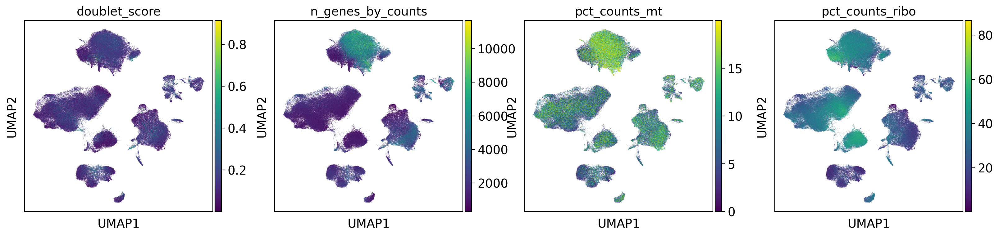

In [18]:
sc.pl.umap(
    adata_crc,
    color=["doublet_score", "n_genes_by_counts", "pct_counts_mt", "pct_counts_ribo"],
    color_map="viridis",
    save="QC_covariates.pdf",
)

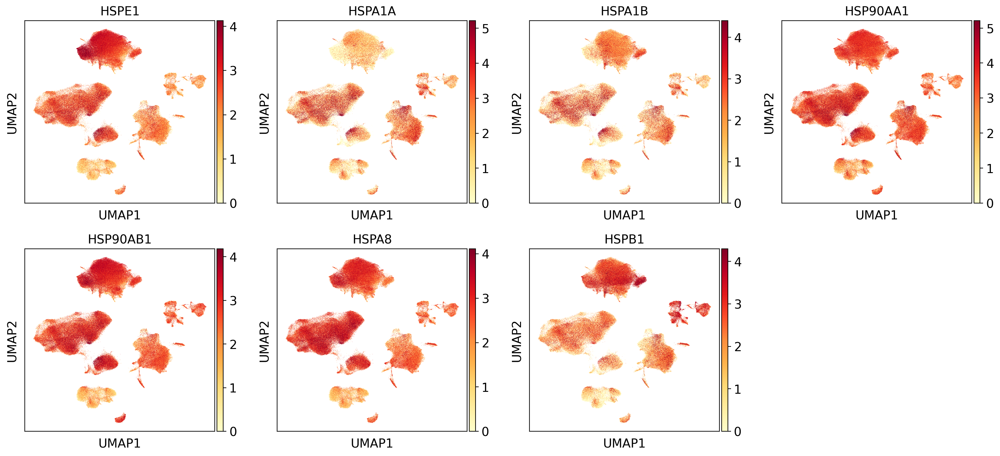

In [19]:
### markers for stress
# HSP
dissocation_markers_dict = {
    "shock protein": [
        "HSPE1",
        "HSPA1A",
        "HSPA1B",
        "HSP90AA1",
        "HSP90AB1",
        "HSPA8",
        "HSPB1",
    ],
    "immediate early genes": ["FOS", "JUN"],
}

sc.pl.umap(
    adata_crc,
    color=dissocation_markers_dict["shock protein"],
    vmax="p99",
    use_raw=True,
    vmin=0,
    color_map="YlOrRd",
    save="general_HSPmarkers.pdf",
    show=True,
)

### Differential expression to get DE genes upregulated per cluster 

In [20]:
# issue here https://github.com/theislab/single-cell-tutorial/issues/97
# This seems to be a scanpy bug as you can see here and here. The latter issue suggests to just add the line:
# adata.uns['log1p']["base"] = None after reading again, or downgrading to AnnData<0.8.
# Either way, this should be fixed soon by the maintenance team.
adata_crc.uns["log1p"]["base"] = None

In [21]:
sc.tl.rank_genes_groups(
    adata_crc,
    groupby="leiden_scVI",
    reference="rest",
    method="wilcoxon",
    use_raw=True,
    layer=None,
    pts=True,
    corr_method="benjamini-hochberg",
    key_added="rank_genes_wilcoxon",
)

categories: 0, 1, 2, etc.
var_group_labels: Epithelial, Myeloid, Granulocyte, etc.


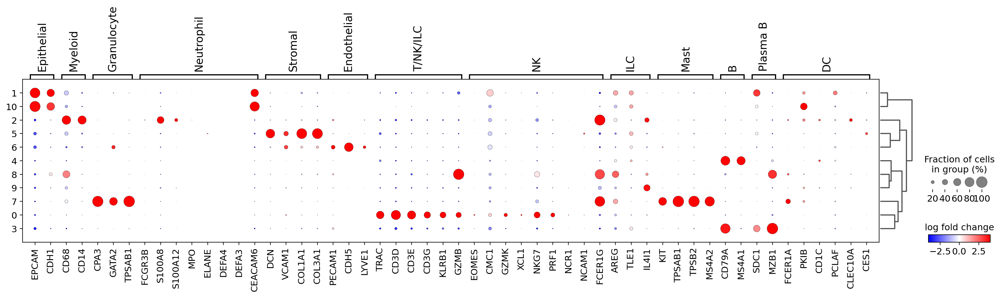

In [22]:
sc.pl.rank_genes_groups_dotplot(
    adata_crc,
    groupby="leiden_scVI",
    key="rank_genes_wilcoxon",
    var_names=markers,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-4,
    vmax=4,
    min_logfoldchange=1,
    colorbar_title="log fold change",
    save="general_dotplot.pdf",
    show=True,
)

In [23]:
adata_crc

AnnData object with n_obs × n_vars = 328063 × 2000
    obs: 'Patient', 'Sample', 'Cell_type', 'Cell_subtype', 'Tissue', 'Therapy', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'cell_source', '_scvi_batch', '_scvi_labels', 'S_score', 'G2M_score', 'phase', 'cell_cycle_diff', 'leiden_scVI'
    var: 'n_cells_by_counts-Che', 'total_counts-Che', 'mean_counts-Che', 'pct_dropout_by_counts-Che', 'n_cells_by_counts-KUL', 'total_counts-KUL', 'mean_counts-KUL', 'pct_dropout_by_counts-KUL', 'n_cells_by_counts-Pelka', 'total_counts-Pelka', 'mean_counts-Pelka', 'pct_dropout_by_counts-Pelka', 'n_cells_by_counts-SMC', 'total_counts-SMC', 'mean_counts-SMC', 'pct_dropout_by_counts-SMC', 'n_cells_by_counts-Wu', 'total_counts-Wu', 'mean_counts-Wu', 'pct_dropout_by_counts-Wu', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns

In [24]:
# write to file
adata_crc.write(
    DIR2SAVE.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_clustering.h5ad")
)

In [25]:
DIR2SAVE

PosixPath('/data/BCI-CRC/nasrine/data/CRC/Primary_CRC_dataset/20mt/annotation_global')

### Cell annotation

In [5]:
adata_crc = sc.read_h5ad(
    DIR2SAVE.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_clustering.h5ad")
)

In [6]:
DIR2SAVE

PosixPath('/data/BCI-CRC/nasrine/data/CRC/Primary_CRC_dataset/20mt/annotation_global')

In [8]:
old_to_new = {
    "0": "T-NK-ILC",
    "1": "Epithelial",
    "2": "Myeloid",
    "3": "Plasma",
    "4": "B",
    "5": "Stromal",
    "6": "Endothelial",
    "7": "Mast",
    "8": "Myeloid",
    "9": "Myeloid",
    "10": "Epithelial"
}

In [9]:
adata_crc.obs["Annotation_scVI"] = (
    adata_crc.obs["leiden_scVI"].map(old_to_new).astype("category")
)

### Set colours for cell types 

`
'Epithelial': '#fdb462'
'T-NK-ILC': '#f768a1' not #'#fccde5'
'Myeloid': '#80b1d3'
'Mast:'#969696'
'Stromal': '#b3de69'
'Endothelial': '#8dd3c7'
'B': '#bc80bd'
'Plasma': '#bebada'
'Hepatocyte':'#fb8072'
'Cholangiocyte': '#ccebc5`

In [10]:
# set colours for cell types, need to know order
adata_crc.obs.Annotation_scVI.cat.categories.values.tolist()

['B',
 'Endothelial',
 'Epithelial',
 'Mast',
 'Myeloid',
 'Plasma',
 'Stromal',
 'T-NK-ILC']

In [11]:
# colour for met
pal_dict = {"B": "#BEBADA",
            "Endothelial": "#8DD3C7",
            "Epithelial": "#FB8072",#E41A1C #FB8072
            "Hepatocyte": "#FDB462",
            "Mast": "#fccde5", #"#000000",
            "Myeloid": "#80B1D3",
            "Plasma": "#7570B3",#B3B3B3
            "Stromal": "#B3DE69",
            "T-NK-ILC": "#F781BF"
           } 

In [12]:
# same order as categories
adata_crc.uns["Annotation_scVI_colors"] = [
    pal_dict["B"],
    pal_dict["Endothelial"],
    pal_dict["Epithelial"],
    pal_dict["Mast"],
    pal_dict["Myeloid"],
    pal_dict["Plasma"],
    pal_dict["Stromal"],
    pal_dict["T-NK-ILC"]
]

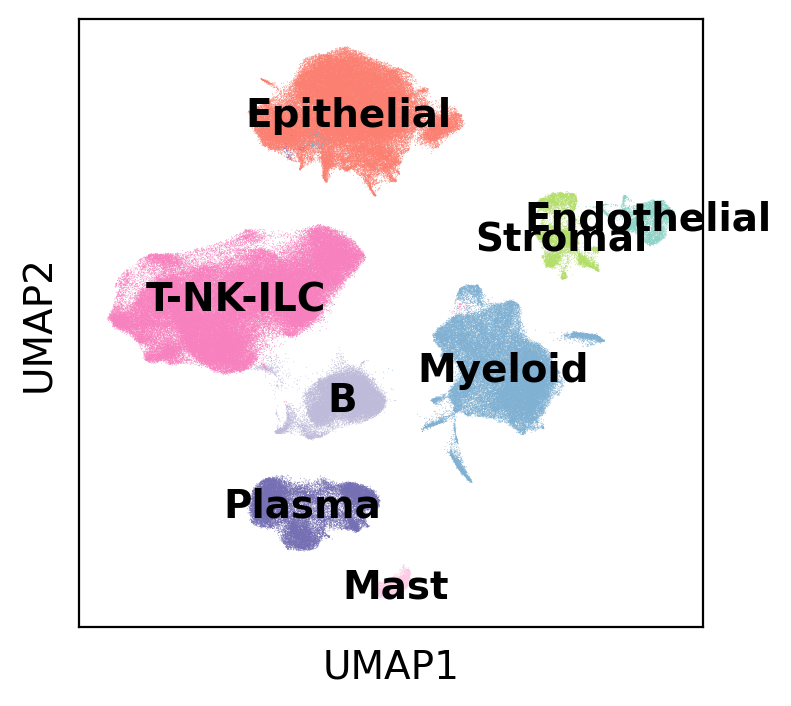

In [16]:
sc.pl.umap(
    adata_crc,
    color="Annotation_scVI",
    show=True,
    legend_loc="on data",
    save="general_annotation.pdf",
    title=""
)

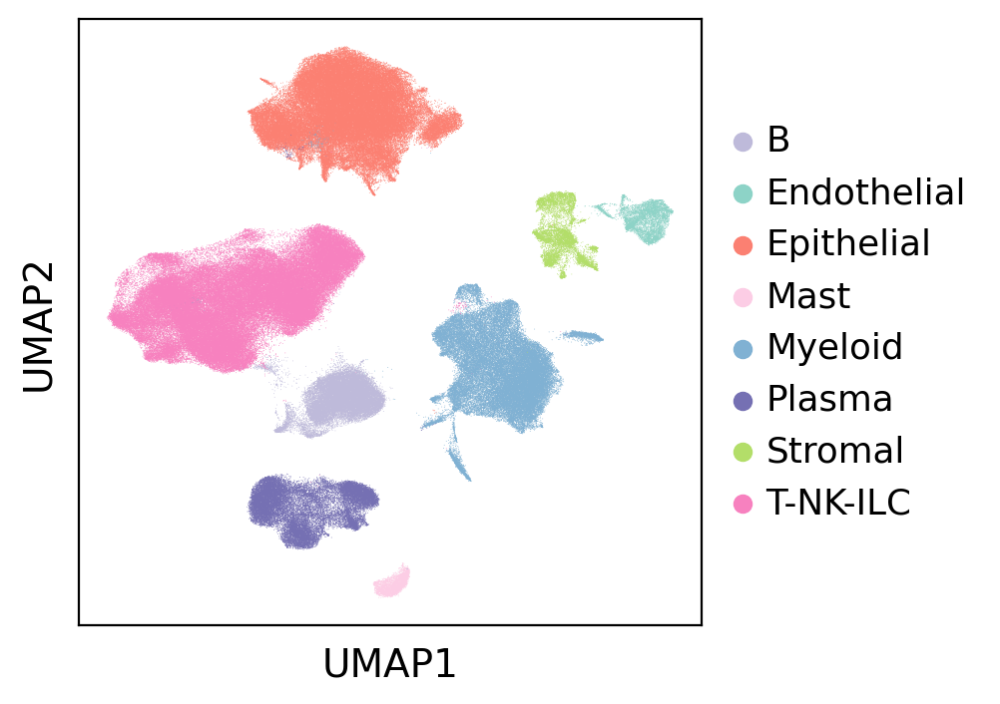

In [15]:
sc.pl.umap(
    adata_crc,
    color="Annotation_scVI",
    show=True,
    legend_loc="right margin",
    save="general_annotation_legend_side.pdf",
    title=""
)

In [17]:
# set colours for therapy
adata_crc.obs.Therapy.cat.categories

Index(['NAC', 'naive'], dtype='object')

In [18]:
adata_crc.uns["Therapy_colors"] = ["#ff7f00", "#377eb8"]

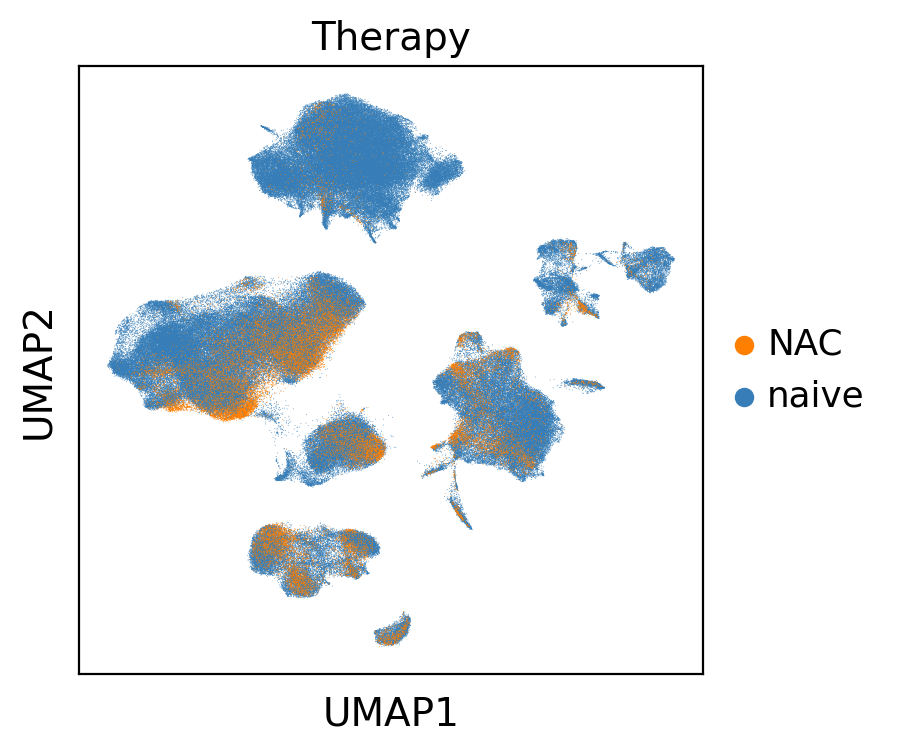

In [19]:
sc.pl.umap(adata_crc, color="Therapy", show=True)

### write to file

In [20]:
# write to file
adata_crc.write(
    DIR2SAVE.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_clustering.h5ad")
)

# write csv of annotations
adata_crc.obs["Annotation_scVI"].to_csv(
    DIR2SAVE.joinpath(
        "SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_annotations_general.txt"
    ),
    sep="\t",
    index=True,
    header=True,
)

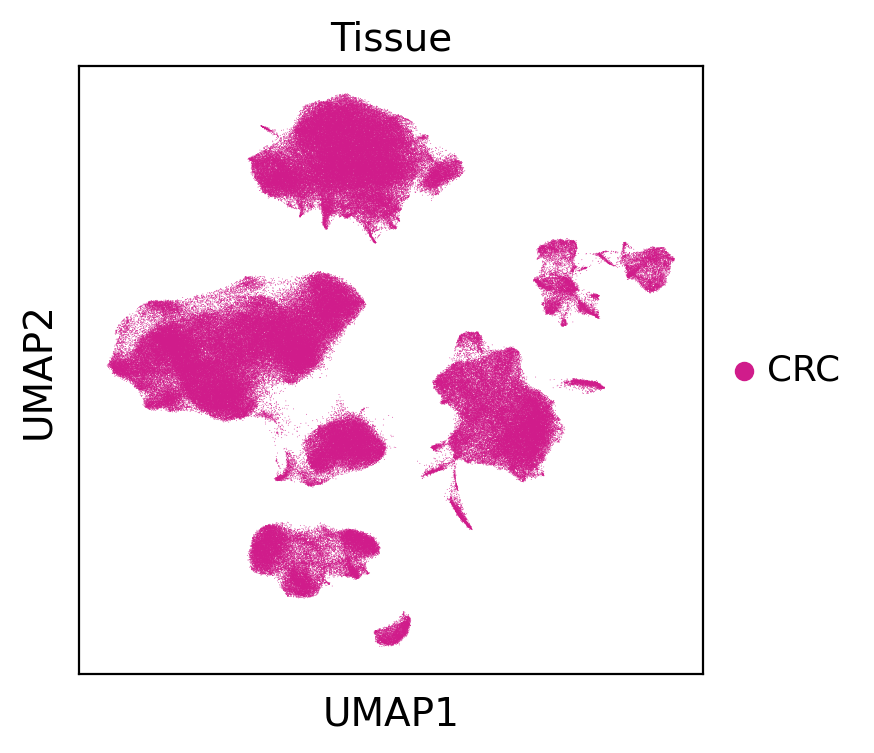

In [21]:
sc.pl.umap(adata_crc, color="Tissue", show=True)

In [22]:
adata_crc.uns["Tissue_colors"]

array(['#d01c8b'], dtype=object)

In [4]:
adata_crc = sc.read_h5ad(DIR2SAVE.joinpath("SMC_KUL_Pelka_Che_Wu_CRC_integrated_scvi_hvg_clustering.h5ad"))

In [30]:
adata_crc.shape

(328063, 2000)

In [23]:
adata_crc.obs.Annotation_scVI.value_counts()

T-NK-ILC       116579
Epithelial      91114
Myeloid         53248
Plasma          26474
B               23094
Stromal          8694
Endothelial      5682
Mast             3178
Name: Annotation_scVI, dtype: int64

In [25]:
adata_crc.obs.cell_source.cat.categories

Index(['SMC', 'KUL', 'Pelka', 'Che', 'Wu'], dtype='object')

In [26]:
adata_crc[adata_crc.obs.cell_source=="SMC"].obs.Annotation_scVI.value_counts()

Epithelial     17440
T-NK-ILC       16710
Myeloid         6364
B               2053
Stromal         1962
Plasma          1890
Endothelial      773
Mast               9
Name: Annotation_scVI, dtype: int64

In [27]:
adata_crc[adata_crc.obs.cell_source=="KUL"].obs.Annotation_scVI.value_counts()

Epithelial     2206
T-NK-ILC       1919
Stromal        1706
Myeloid         947
Endothelial     618
B               471
Plasma          267
Mast             78
Name: Annotation_scVI, dtype: int64

In [28]:
adata_crc[adata_crc.obs.cell_source=="Che"].obs.Annotation_scVI.value_counts()

T-NK-ILC       27367
Epithelial      8312
Myeloid         7673
B               4124
Plasma          2907
Stromal         1149
Mast             662
Endothelial      211
Name: Annotation_scVI, dtype: int64

In [29]:
adata_crc[adata_crc.obs.cell_source=="Wu"].obs.Annotation_scVI.value_counts()

T-NK-ILC      17461
Plasma         4404
B              4390
Myeloid        3010
Epithelial       28
Mast              5
Name: Annotation_scVI, dtype: int64

In [24]:
adata_crc[adata_crc.obs.cell_source=="Pelka"].obs.Annotation_scVI.value_counts()

Epithelial     63128
T-NK-ILC       53122
Myeloid        35254
Plasma         17006
B              12056
Endothelial     4080
Stromal         3877
Mast            2424
Name: Annotation_scVI, dtype: int64

In [ ]:
adata_crc.obs.Annotation_scVI.value_counts()

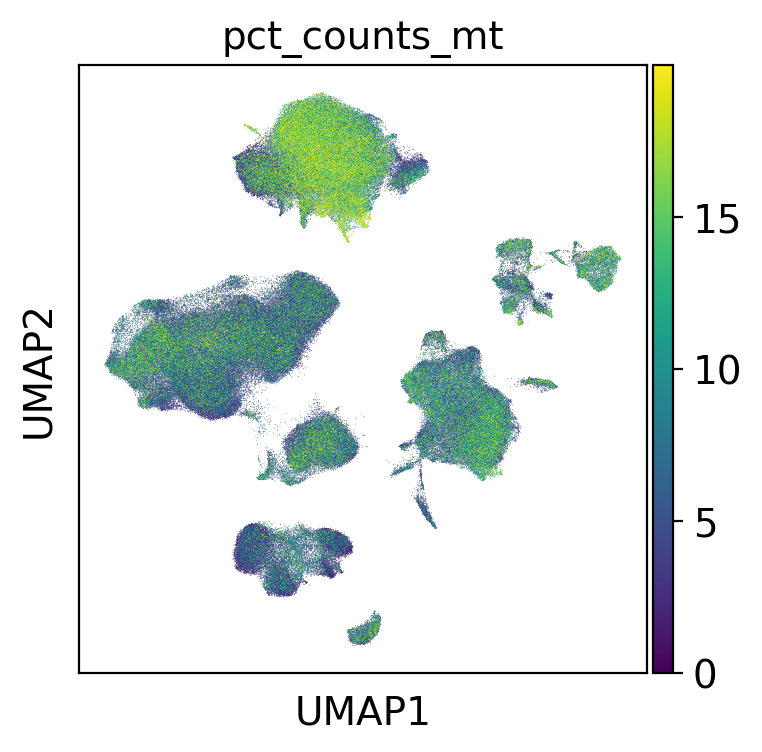

In [32]:
sc.pl.umap(adata_crc, color="pct_counts_mt")